
# **📁 FACE CLUSTERING**



# **🎯 Project Objective:**
The objective of this project is to automatically detect, recognize, and group facial images based on identity, using a combination of deep learning-based face recognition models and unsupervised clustering algorithms.

By leveraging pre-trained neural networks and unsupervised learning, the system is capable of:

1. 🔍 Detecting and aligning faces from uploaded images using MTCNN (Multi-task
   Cascaded Convolutional Networks)

2. 🧠 Extracting high-dimensional facial embeddings using InceptionResnetV1,
   trained on the VGGFace2 dataset

3. 📊 Clustering facial features using DBSCAN, an unsupervised density-based
   algorithm, to group similar faces together

4. 🖼️ Visualizing clusters by showing the assigned cluster number for each
   image

🚀 What You’ll See at the End (Outcome):
Once the code runs, we will get:

1. 🧠 Faces Detected and Recognized: The system picks out faces from all uploaded photos — even from group pictures!

2. 🧬 Grouped by Identity: Each photo is analyzed and automatically grouped with others of the same person using AI — no names or labels required.

3. 🖼️ Visual Grid of Results: You’ll see all your images neatly arranged with their cluster numbers (like “Cluster 0,” “Cluster 1”), showing which faces belong together.

# **🧩 STEP 1: Import Required Libraries**

In [14]:
from google.colab import files
from PIL import Image
import torch
from facenet_pytorch import MTCNN, InceptionResnetV1
import matplotlib.pyplot as plt
from sklearn.cluster import DBSCAN
import numpy as np
import os
import math



#**🖼️ STEP 2: Upload Face Images**

In [15]:
print("📤 Upload your face images (JPEG/PNG)...")
uploaded = files.upload()

📤 Upload your face images (JPEG/PNG)...


Saving Gloria_Macapagal_Arroyo_0010.jpg to Gloria_Macapagal_Arroyo_0010 (3).jpg
Saving Gloria_Macapagal_Arroyo_0011.jpg to Gloria_Macapagal_Arroyo_0011 (3).jpg


# **📚 STEP 3: Load and Convert Images to RGB**

In [16]:
# Ensures compatibility for MTCNN (which expects 3-channel RGB images)
image_paths = [f for f in os.listdir() if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
images = [Image.open(path).convert("RGB") for path in image_paths]


# **⚙️ STEP 4: Initialize Models (MTCNN + FaceNet)**

In [17]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f"🖥️ Using device: {device.upper()}")

mtcnn = MTCNN(image_size=160, margin=0, device=device)  # Face detection and alignment
resnet = InceptionResnetV1(pretrained='vggface2').eval().to(device)  # Embedding model

🖥️ Using device: CPU


# **🔍 STEP 5: Detect and Align Faces**
 # **🔐 STEP 6: Get Face Embeddings**

In [18]:
aligned = []
valid_paths = []
valid_images = []

print("\n🔎 Detecting faces in images...")
for img, path in zip(images, image_paths):
    x = mtcnn(img)
    if x is not None:
        aligned.append(x)
        valid_paths.append(path)
        valid_images.append(img)
    else:
        print(f"[!] No face detected in {path}")

# 🚫 If no valid face was detected
if len(aligned) == 0:
    print("❌ No faces detected in any image. Please try with clearer images.")
else:
    aligned = torch.stack(aligned).to(device)
    embeddings = resnet(aligned).detach().cpu().numpy()


🔎 Detecting faces in images...


# **Step 7: Cluster the Face Embeddings Using DBSCAN**

In [22]:
    print("\n🔎 Step 7: Clustering Embeddings...")
    cluster = DBSCAN(eps=0.9, min_samples=1, metric='euclidean')
    labels = cluster.fit_predict(embeddings)


🔎 Step 7: Clustering Embeddings...


  # **🧾 STEP 8: Display Clustering Results**

In [20]:
    print("\n📌 Cluster Results:")
    for i, label in enumerate(labels):
        print(f"Image '{valid_paths[i]}' → Cluster {label}")



📌 Cluster Results:
Image '00000091.jpg' → Cluster 0
Image 'Halle_Berry_0016.jpg' → Cluster 1
Image '00000065.jpg' → Cluster 2
Image '00000093.jpg' → Cluster 0
Image '00000114.jpg' → Cluster 3
Image '00000059.jpg' → Cluster 2
Image '00000119.jpg' → Cluster 3
Image 'David_Wells_0004.jpg' → Cluster 4
Image '00000082.jpg' → Cluster 0
Image '00000122 (1).jpg' → Cluster 3
Image 'Halle_Berry_0005 (2).jpg' → Cluster 1
Image '00000077.jpg' → Cluster 0
Image 'Halle_Berry_0005 (1).jpg' → Cluster 1
Image 'Gloria_Macapagal_Arroyo_0011 (1).jpg' → Cluster 5
Image 'Halle_Berry_0002.jpg' → Cluster 1
Image 'Halle_Berry_0007 (2).jpg' → Cluster 1
Image '00000126.jpg' → Cluster 3
Image '00000092.jpg' → Cluster 0
Image 'Halle_Berry_0015.jpg' → Cluster 1
Image '00000121.jpg' → Cluster 3
Image '00000099.jpg' → Cluster 3
Image 'Arnold_Schwarzenegger_0033.jpg' → Cluster 6
Image 'Gloria_Macapagal_Arroyo_0010 (2).jpg' → Cluster 5
Image '00000081.jpg' → Cluster 0
Image 'Halle_Berry_0007 (1).jpg' → Cluster 1
Image

# **Step 9: Visualize the Clustered Faces in a Grid**


🖼️ Step 9: Visualizing Results...


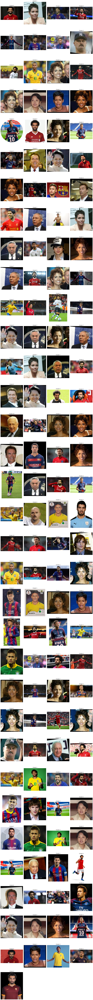

In [23]:
    print("\n🖼️ Step 9: Visualizing Results...")

    num_images = len(valid_images)
    cols = 4  # Customize the number of columns
    rows = math.ceil(num_images / cols)
    fig, axs = plt.subplots(rows, cols, figsize=(cols * 4, rows * 5))

    axs = axs.flatten()
    for i in range(num_images):
        axs[i].imshow(valid_images[i])
        axs[i].set_title(f"Cluster {labels[i]}")
        axs[i].axis('off')

    # Hide extra axes if any
    for j in range(num_images, len(axs)):
        axs[j].axis('off')

    plt.tight_layout()
    plt.show()
